In [1]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from ipywidgets import interact
from tqdm.notebook import tqdm
from sklearn.metrics import f1_score, accuracy_score, balanced_accuracy_score, confusion_matrix
from scipy import signal
from scipy.fftpack import fft
import math

# Data

In [2]:
train_x = np.load('data/0_x_train.npy')
test_x  = np.load('data/0_x_test.npy')
train_y = np.load('data/1_linear_preds_train.npy')
test_y  = np.load('data/1_linear_preds_test.npy')

train_noise_real    = np.load('data/2_noise_real_train.npy')
train_noise_linPred = np.load('data/2_noise_linPred_train.npy')
test_noise_linPred  = np.load('data/2_noise_linPred_test.npy')

# Fourier

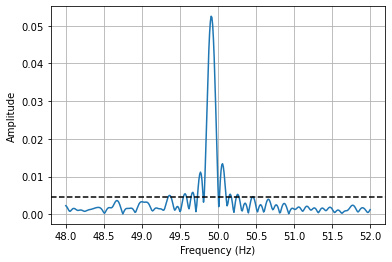

In [3]:
def fourier(signal, freq_muestreo, limit_freqs=None, res=1, plot=False, title=""):
    N = len(signal) * res
    T = 1.0 / freq_muestreo
    
    freqs = np.linspace(0.0, 1.0/(2.0*T), N//2) # xfft
    yfft  = fft(signal, n=N)[:N//2]
    ampls = 2.0/len(signal) * np.abs(yfft)
    fases = np.angle(yfft) + math.pi/2 # NO SE PQ el + math.pi/2 !!!!!!!!!!!!!
    #print(len(freqs), len(np.abs(ampls)),len(fases))
    
    threshold = ampls.std() * 6
    
    #for f,a in zip(freqs,ampls):
    #    if a>threshold: print(f)
        
    if limit_freqs:
        lowFreq,topFreq = limit_freqs
        freqs = freqs[math.floor(lowFreq * T * N):math.ceil(topFreq * T * N)]
        ampls = ampls[math.floor(lowFreq * T * N):math.ceil(topFreq * T * N)]
        fases = fases[math.floor(lowFreq * T * N):math.ceil(topFreq * T * N)]
        
    if plot:
        #plt.figure(figsize=(16, 4))
        plt.plot(freqs, ampls)
        plt.title(title)
        plt.xlabel("Frequency (Hz)")
        plt.ylabel("Amplitude")
        plt.axhline(threshold, color='k', linestyle='--')
        plt.grid()
        plt.show()
        
    return freqs, ampls, fases

#plt.figure(figsize=(16, 4))
fourier(train_noise_real[:100000], freq_muestreo=10000, limit_freqs=(48,52), res=10, plot=True);

# QUITAR FREQS de forma iterativa

In [4]:
def wave(freq, ampl, phase, n_points):
    #return ampl * np.sin( np.arange(n_points)*freq + phase)
    return ampl * np.sin( np.arange(n_points)* 2 * math.pi / 10000 * freq + phase)

In [5]:
def remove_freqs(signal, noise, num_segments, limit_freqs=(10,4900), std_mul=8):
    
    noise_without_freqs  = noise.copy()
    signal_without_freqs = signal.copy()

    for i, (n,s) in enumerate(zip(np.split(noise_without_freqs,  num_segments),
                                  np.split(signal_without_freqs, num_segments))):
        
        print("\nSegmento", i, end=":\t")

        freqs, ampls, fases = fourier(n, freq_muestreo=10000, limit_freqs=limit_freqs, res=100);
        threshold = ampls.std() * std_mul

        while(ampls.max() > threshold):

            freq = freqs[ampls.argmax()]
            ampl = ampls[ampls.argmax()]
            fase = fases[ampls.argmax()]

            print(str(round(freq,2))+" ", end="")

            n -= wave(freq, ampl, fase, len(n))
            s -= wave(freq, ampl, fase, len(n))

            freqs, ampls, fases = fourier(n, freq_muestreo=10000, limit_freqs=limit_freqs, res=100)
            
    return signal_without_freqs, noise_without_freqs

# QUITAR FREQS: TRAIN GT

In [6]:
train_x_without_freqs, train_n_without_freqs = remove_freqs(signal=train_x,
                                                            noise=train_noise_real,
                                                            num_segments=50,
                                                            limit_freqs=(25,4900),
                                                            std_mul=8)


Segmento 0:	49.91 349.39 
Segmento 1:	50.11 1152.65 3139.98 1252.87 1453.35 2002.9 
Segmento 2:	50.14 1153.24 1454.1 1554.37 1253.52 
Segmento 3:	50.12 1152.62 1996.94 4002.81 
Segmento 4:	49.95 3135.29 3135.49 1148.71 349.61 1248.61 
Segmento 5:	49.94 3134.09 1148.45 349.52 2836.84 
Segmento 6:	49.92 1148.26 1248.1 3186.43 3186.22 2807.82 3186.76 1148.37 3187.09 
Segmento 7:	49.97 1149.35 349.77 2807.76 3182.22 3181.52 
Segmento 8:	50.04 1150.85 1250.93 3161.42 3161.22 1551.16 2804.21 1450.92 
Segmento 9:	49.89 1147.53 1247.33 1446.9 3143.08 2796.27 2796.86 349.25 
Segmento 10:	49.76 50.1 49.58 50.23 50.56 50.0 50.75 50.45 49.91 49.45 48.77 1150.83 1450.47 1150.7 1250.35 
Segmento 11:	50.01 49.91 49.78 50.24 50.37 1150.81 50.48 50.09 1451.2 49.47 1250.97 
Segmento 12:	50.08 49.86 50.22 49.68 49.58 50.59 1150.35 1150.53 50.01 50.31 1250.8 50.45 1250.32 1550.81 350.25 49.5 
Segmento 13:	50.17 49.88 49.61 50.59 49.76 50.32 1150.82 1250.91 50.5 1150.63 1451.18 1550.82 50.08 
Segmento 14:

# QUITAR FREQS de forma iterativa TRAIN Pred

In [7]:
train_x_without_freqs2, train_n_without_freqs2 = remove_freqs(signal=train_x,
                                                              noise=train_noise_linPred,
                                                              num_segments=50,
                                                              limit_freqs=(25,4900),
                                                              std_mul=8)


Segmento 0:	49.91 349.39 
Segmento 1:	50.11 1152.65 3139.97 1252.86 2002.91 1453.37 
Segmento 2:	50.14 1153.24 1454.1 1554.37 1253.52 
Segmento 3:	50.12 1996.94 4002.81 1152.62 
Segmento 4:	49.95 3135.5 3135.3 1148.71 349.61 
Segmento 5:	49.94 3134.09 1148.44 349.52 2836.68 
Segmento 6:	49.92 1148.26 3186.43 1248.1 3186.22 2807.82 3186.77 1148.37 
Segmento 7:	49.97 1149.34 349.77 2807.75 3182.22 
Segmento 8:	50.04 1150.85 1250.93 3161.42 1551.15 3161.21 1450.92 2804.21 
Segmento 9:	49.89 1147.53 1247.32 1446.9 3143.08 2796.28 
Segmento 10:	50.1 49.75 49.58 50.22 50.56 50.0 50.75 50.46 48.57 48.77 1150.84 1150.7 49.92 49.45 1450.47 
Segmento 11:	50.01 49.91 49.78 50.24 50.37 1150.81 50.07 50.47 1451.2 1250.98 49.47 50.17 
Segmento 12:	50.08 49.85 49.68 50.22 49.58 50.59 1150.55 1150.37 50.0 50.46 1250.32 1250.8 50.31 350.26 
Segmento 13:	50.17 49.88 49.61 50.59 49.76 50.32 1150.82 1250.91 50.5 1150.63 1550.82 
Segmento 14:	49.79 50.15 49.93 49.71 50.32 50.79 1150.27 50.51 49.53 49.38 4

# QUITAR FREQS de forma iterativa TEST Pred

In [8]:
test_x_without_freqs, test_n_without_freqs = remove_freqs(signal=test_x,
                                                          noise=test_noise_linPred,
                                                          num_segments=20,
                                                          limit_freqs=(25,4900),
                                                          std_mul=8)


Segmento 0:	50.07 1151.48 2690.2 
Segmento 1:	49.92 3116.86 
Segmento 2:	50.16 3121.94 1153.31 1153.39 1153.78 
Segmento 3:	49.99 38.22 
Segmento 4:	49.75 49.92 50.13 49.61 50.61 50.3 50.41 49.43 1149.31 1249.29 1149.65 50.75 49.8 
Segmento 5:	49.9 63.62 
Segmento 6:	49.92 1148.2 1248.05 349.45 1148.31 
Segmento 7:	49.96 26.69 
Segmento 8:	49.94 1248.53 1148.65 1448.29 
Segmento 9:	49.96 1149.11 1448.77 1249.05 1149.22 
Segmento 10:	49.9 2723.72 
Segmento 11:	50.1 1152.34 
Segmento 12:	50.07 40.25 
Segmento 13:	49.93 3190.01 1148.46 1248.2 51.88 
Segmento 14:	49.95 3161.64 1148.76 
Segmento 15:	49.91 1147.85 1247.67 1447.28 3143.66 
Segmento 16:	49.94 50.49 1148.5 1248.4 
Segmento 17:	49.99 3135.78 1149.67 349.93 1449.57 3135.62 3135.28 
Segmento 18:	49.97 3135.34 1249.28 1149.35 
Segmento 19:	49.95 3134.67 3135.02 1148.78 1012.32 3134.81 

# Plot TRAIN

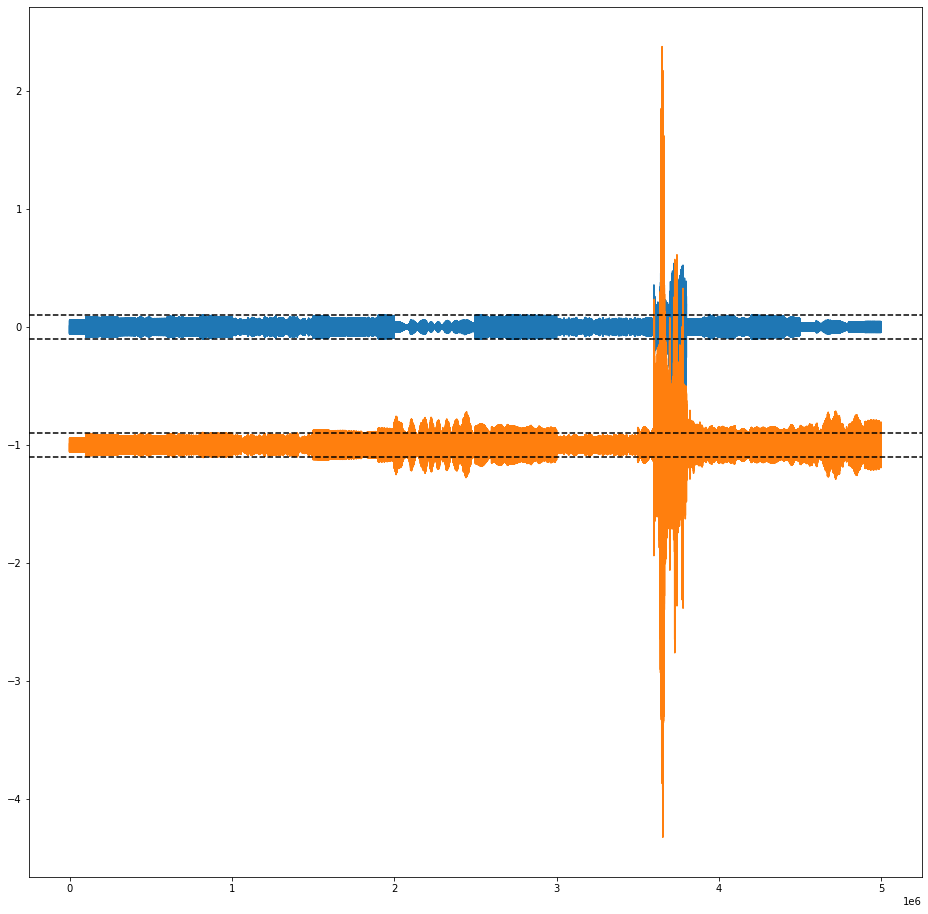

In [16]:
plt.figure(figsize=(16, 16)); 
plt.plot((train_noise_linPred-train_n_without_freqs2))
plt.plot((train_noise_real-train_n_without_freqs)-1)
plt.axhline(0.1, color='k', linestyle='--')
plt.axhline(-0.1, color='k', linestyle='--')
plt.axhline(-0.9, color='k', linestyle='--')
plt.axhline(-1.1, color='k', linestyle='--')

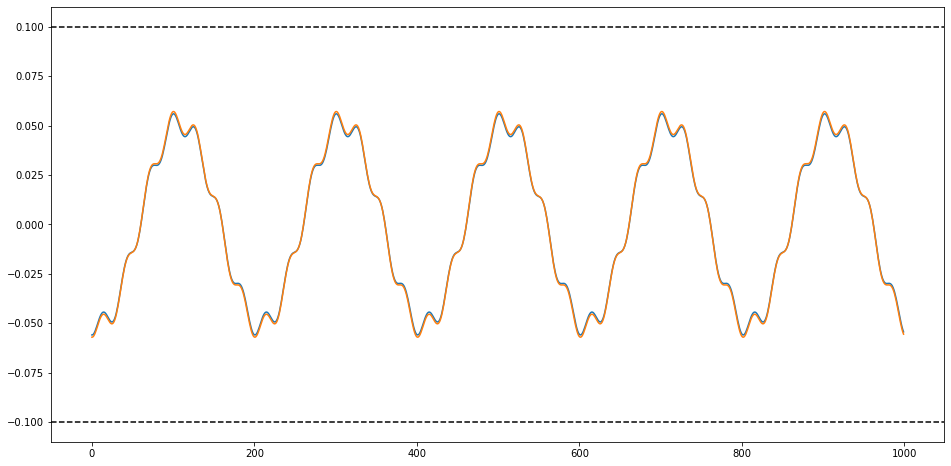

In [18]:
plt.figure(figsize=(16, 8)); 
plt.plot((train_noise_linPred-train_n_without_freqs2)[:1000])
plt.plot((train_noise_real-train_n_without_freqs)[:1000])
plt.axhline(0.1, color='k', linestyle='--')
plt.axhline(-0.1, color='k', linestyle='--')

# Plot TEST

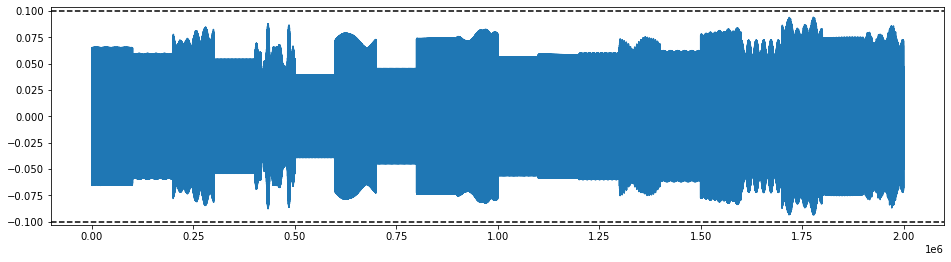

In [19]:
plt.figure(figsize=(16, 4)); 
plt.plot((test_x-test_x_without_freqs))
plt.axhline(0.1, color='k', linestyle='--')
plt.axhline(-0.1, color='k', linestyle='--')

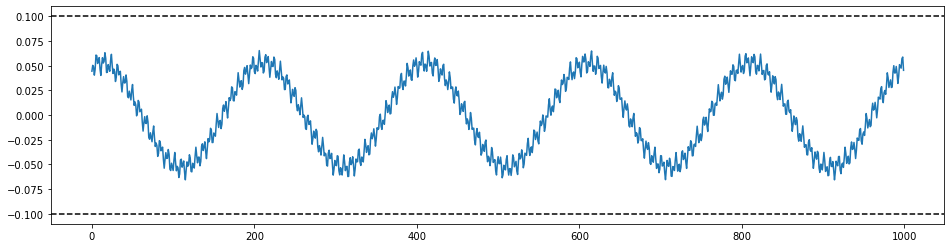

In [12]:
plt.figure(figsize=(16, 4)); 
plt.plot((test_x-test_x_without_freqs)[:1000])
plt.axhline(0.1, color='k', linestyle='--')
plt.axhline(-0.1, color='k', linestyle='--')

# Mostrar FFTs

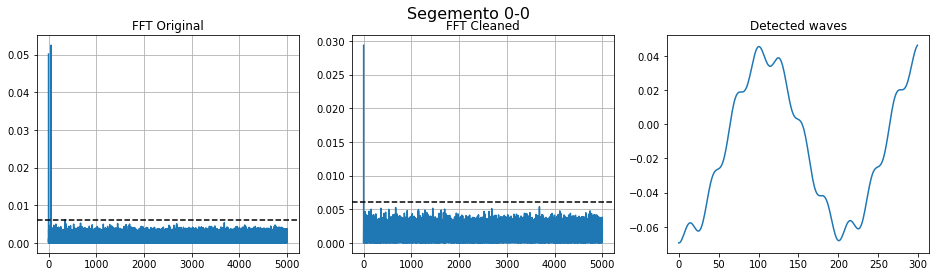

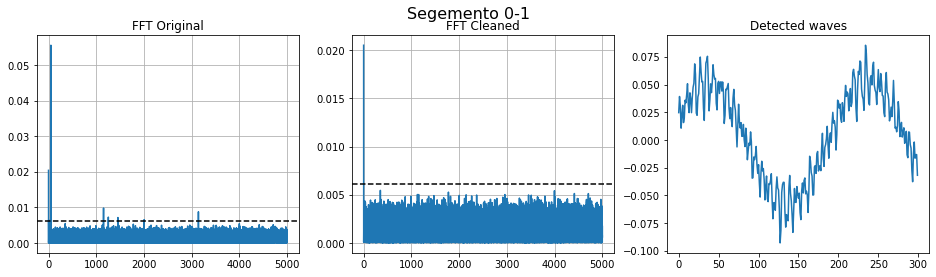

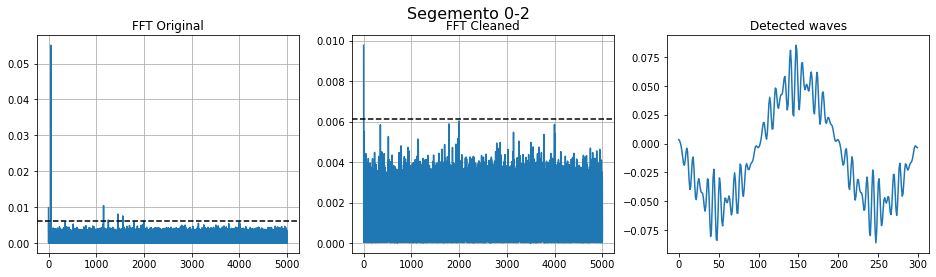

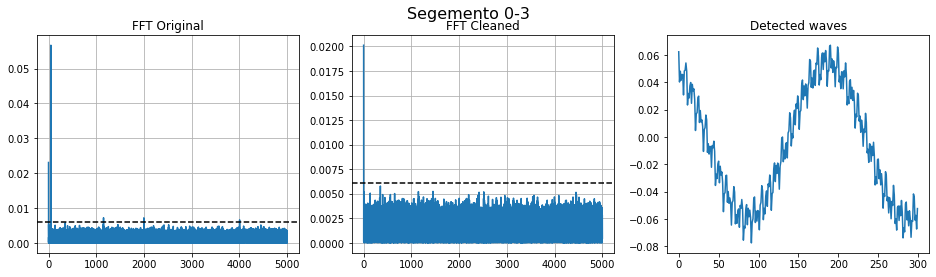

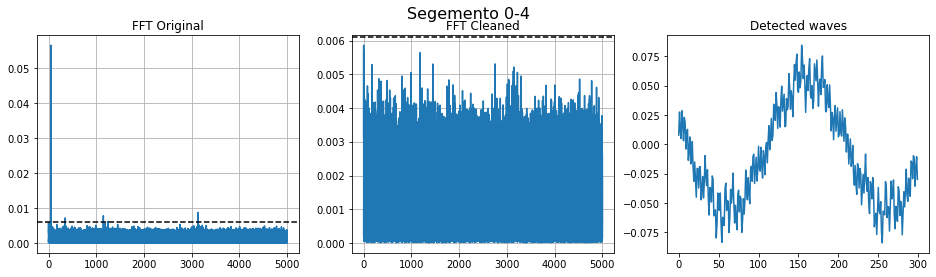

...

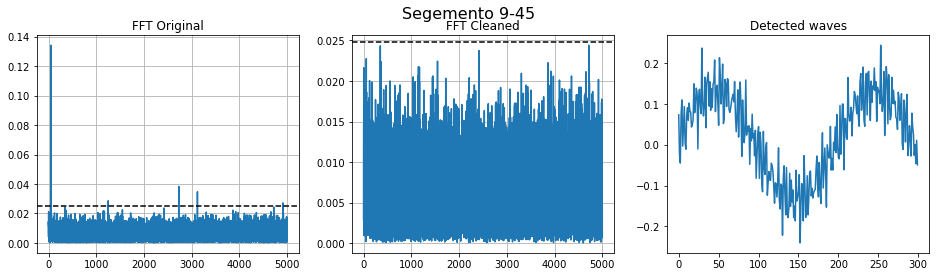

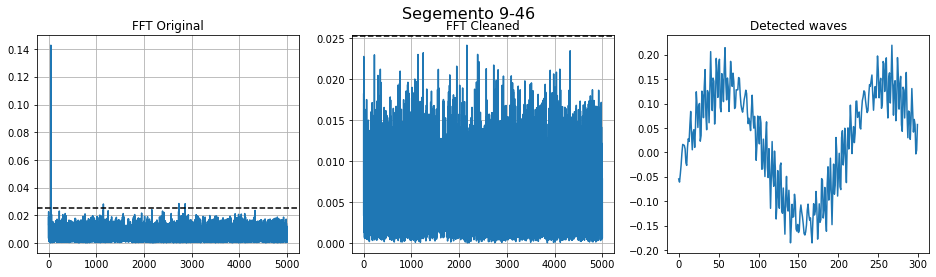

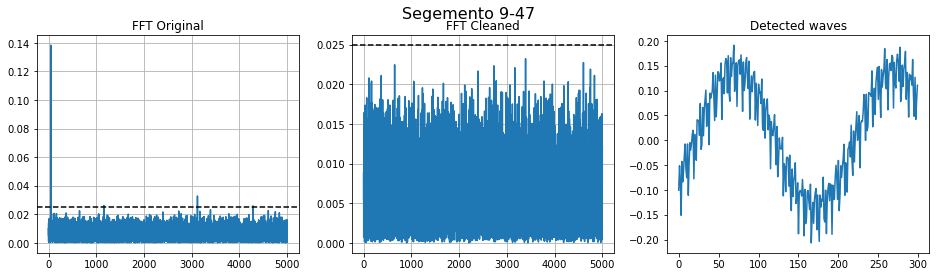

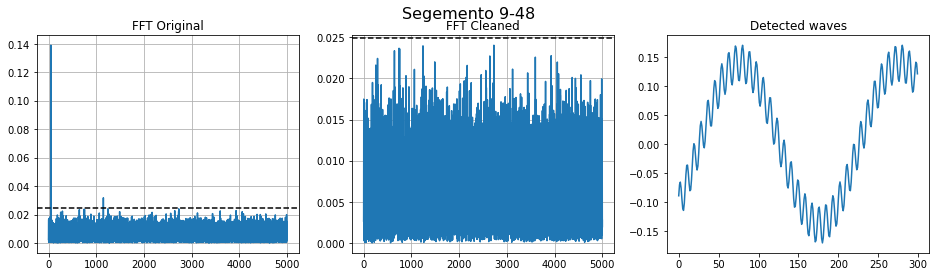

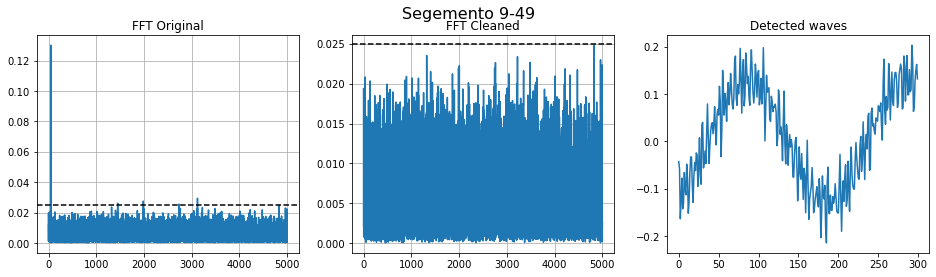

In [7]:
plt.rcParams.update({'figure.max_open_warning': 0})

for i, (n_orig_i, n_clean_i) in enumerate(zip(np.split(train_noise_real, 10), np.split(train_n_without_freqs, 10))):
    if i in [2,6,7]: num_segments = 50; std_mul = 6
    elif i in [4,9]: num_segments = 50; std_mul = 6
    else: num_segments = 5; std_mul = 8
        
    #if i == 5: break
    
    for j, (n_orig, n_clean) in enumerate(zip(np.split(n_orig_i, num_segments), np.split(n_clean_i, num_segments))):     
        
        fig, ax = plt.subplots(nrows=1, ncols=3, figsize=(16, 4))
        fig.suptitle("Segemento "+str(i)+"-"+str(j), fontsize=16)

        freqs, ampls, _ = fourier(n_orig, 10000, limit_freqs=None, res=10)
        threshold = ampls.std() * std_mul
        ax[0].plot(freqs, ampls)
        ax[0].set_title("FFT Original")
        ax[0].axhline(threshold, color='k', linestyle='--')
        ax[0].grid()
        #ax[0].text(0.5, 0.5, 'matplotlib')

        freqs, ampls, _ = fourier(n_clean, 10000, limit_freqs=None, res=10)
        ax[1].plot(freqs, ampls)
        ax[1].set_title("FFT Cleaned")
        ax[1].axhline(threshold, color='k', linestyle='--')
        ax[1].grid()

        ax[2].plot((n_orig-n_clean)[:300])
        ax[2].set_title("Detected waves")

In [ ]:
plt.rcParams.update({'figure.max_open_warning': 0})

for i, (n_orig_i, n_clean_i) in enumerate(zip(np.split(train_noise_real, 10), np.split(train_n_without_freqs, 10))):
    if i in [2,6,7]: num_segments = 50; std_mul = 6
    elif i in [4,9]: num_segments = 50; std_mul = 6
    else: num_segments = 5; std_mul = 8
        
    #if i == 5: break
    
    for j, (n_orig, n_clean) in enumerate(zip(np.split(n_orig_i, num_segments), np.split(n_clean_i, num_segments))):     
        
        fig, ax = plt.subplots(nrows=1, ncols=3, figsize=(16, 4))
        fig.suptitle("Segemento "+str(i)+"-"+str(j), fontsize=16)

        freqs, ampls, _ = fourier(n_orig, 10000, limit_freqs=None, res=10)
        threshold = ampls.std() * std_mul
        ax[0].plot(freqs, ampls)
        ax[0].set_title("FFT Original")
        ax[0].axhline(threshold, color='k', linestyle='--')
        ax[0].grid()
        #ax[0].text(0.5, 0.5, 'matplotlib')

        freqs, ampls, _ = fourier(n_clean, 10000, limit_freqs=None, res=10)
        ax[1].plot(freqs, ampls)
        ax[1].set_title("FFT Cleaned")
        ax[1].axhline(threshold, color='k', linestyle='--')
        ax[1].grid()

        ax[2].plot((n_orig-n_clean)[:300])
        ax[2].set_title("Detected waves")

# Cheaquear visualmente

# TRAIN (GT)

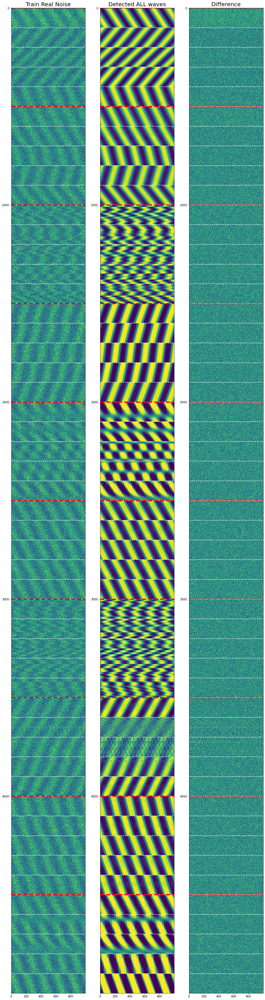

In [20]:
fig, ax = plt.subplots(nrows=1, ncols=3, figsize=(16, 64))

ax[0].imshow(train_noise_real.reshape(-1, 1000).clip(-0.05,0.05), aspect='auto')
#[ax[0].axhline(i, color='k', linestyle='--') for i in range(1000,1500,10)]
#[ax[0].axhline(i, color='k', linestyle='--') for i in range(2000,2500,50)]
#[ax[0].axhline(i, color='k', linestyle='--') for i in range(3000,3500,10)]
#[ax[0].axhline(i, color='k', linestyle='--') for i in range(4500,5000,50)]
[ax[0].axhline(i, color='w', linestyle='--') for i in range(0,5000,100)]
[ax[0].axhline(i, color='r', linestyle='--', linewidth=4) for i in range(0,5000,500)]
ax[0].set_title("Train Real Noise", fontsize=20);

ax[1].imshow((train_noise_real-train_n_without_freqs).reshape(-1, 1000).clip(-0.05,0.05), aspect='auto')
[ax[1].axhline(i, color='w', linestyle='--') for i in range(0,5000,100)]
[ax[1].axhline(i, color='r', linestyle='--', linewidth=4) for i in range(0,5000,500)]
ax[1].set_title("Detected ALL waves", fontsize=20);

ax[2].imshow(train_n_without_freqs.reshape(-1, 1000).clip(-0.02,0.02), aspect='auto')
[ax[2].axhline(i, color='r', linestyle='--', linewidth=4) for i in range(0,5000,500)]
[ax[2].axhline(i, color='w', linestyle='--') for i in range(0,5000,100)]
ax[2].set_title("Difference", fontsize=20);

# TRAIN (PRED)

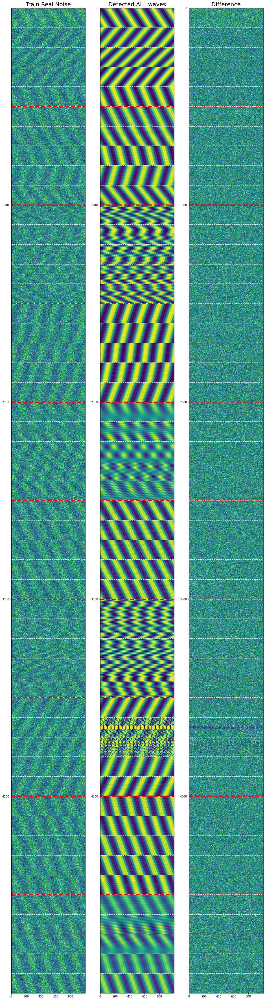

In [21]:
fig, ax = plt.subplots(nrows=1, ncols=3, figsize=(16, 64))

ax[0].imshow(train_noise_real.reshape(-1, 1000).clip(-0.05,0.05), aspect='auto')
#[ax[0].axhline(i, color='k', linestyle='--') for i in range(1000,1500,10)]
#[ax[0].axhline(i, color='k', linestyle='--') for i in range(2000,2500,50)]
#[ax[0].axhline(i, color='k', linestyle='--') for i in range(3000,3500,10)]
#[ax[0].axhline(i, color='k', linestyle='--') for i in range(4500,5000,50)]
[ax[0].axhline(i, color='w', linestyle='--') for i in range(0,5000,100)]
[ax[0].axhline(i, color='r', linestyle='--', linewidth=4) for i in range(0,5000,500)]
ax[0].set_title("Train Real Noise", fontsize=20);

ax[1].imshow((train_noise_linPred-train_n_without_freqs2).reshape(-1, 1000).clip(-0.05,0.05), aspect='auto')
[ax[1].axhline(i, color='w', linestyle='--') for i in range(0,5000,100)]
[ax[1].axhline(i, color='r', linestyle='--', linewidth=4) for i in range(0,5000,500)]
ax[1].set_title("Detected ALL waves", fontsize=20);

ax[2].imshow(train_n_without_freqs2.reshape(-1, 1000).clip(-0.02,0.02), aspect='auto')
[ax[2].axhline(i, color='r', linestyle='--', linewidth=4) for i in range(0,5000,500)]
[ax[2].axhline(i, color='w', linestyle='--') for i in range(0,5000,100)]
ax[2].set_title("Difference", fontsize=20);

# TEST

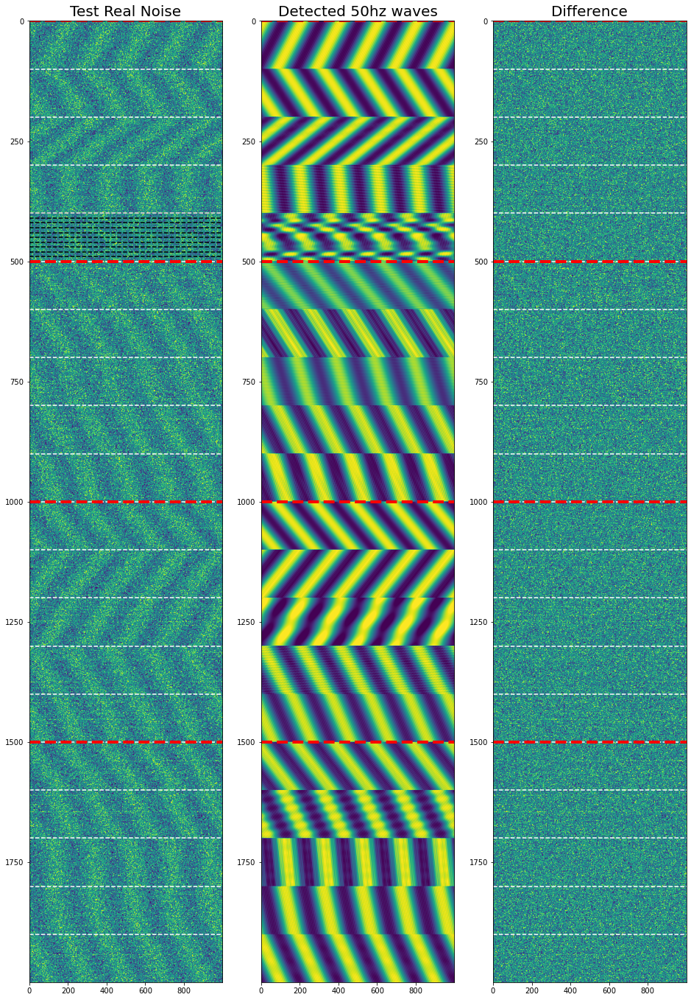

In [16]:
fig, ax = plt.subplots(nrows=1, ncols=3, figsize=(16, 24))

ax[0].imshow(test_noise_linPred.reshape(-1, 1000).clip(-0.05,0.05), aspect='auto')
[ax[0].axhline(i, color='k', linestyle='--') for i in range(400,500,10)]
[ax[0].axhline(i, color='w', linestyle='--') for i in range(0,2000,100)]
[ax[0].axhline(i, color='r', linestyle='--', linewidth=4) for i in range(0,2000,500)]
ax[0].set_title("Test Real Noise", fontsize=20);

ax[1].imshow((test_noise_linPred-test_n_without_freqs).reshape(-1, 1000).clip(-0.05,0.05), aspect='auto')
[ax[1].axhline(i, color='r', linestyle='--', linewidth=4) for i in range(0,2000,500)]
ax[1].set_title("Detected 50hz waves", fontsize=20);

ax[2].imshow(test_n_without_freqs.reshape(-1, 1000).clip(-0.05,0.05), aspect='auto')
[ax[2].axhline(i, color='w', linestyle='--') for i in range(0,2000,100)]
[ax[2].axhline(i, color='r', linestyle='--', linewidth=4) for i in range(0,2000,500)]
ax[2].set_title("Difference", fontsize=20);

# Guardar 50 Hz

In [23]:
np.save('data/3_x_without_freqs_real_train.npy', train_x_without_freqs)
np.save('data/3_x_without_freqs_linPred_train.npy', train_x_without_freqs2)
np.save('data/3_x_without_freqs_linPred_test.npy',  test_x_without_freqs)